### 3D system


Original system  - using $S^{*}_{E} - S^{*}_{\text{avg}}$ as reference

k/d = 100000
a_N = 80.685
a_L = 38.04
b = -40.0


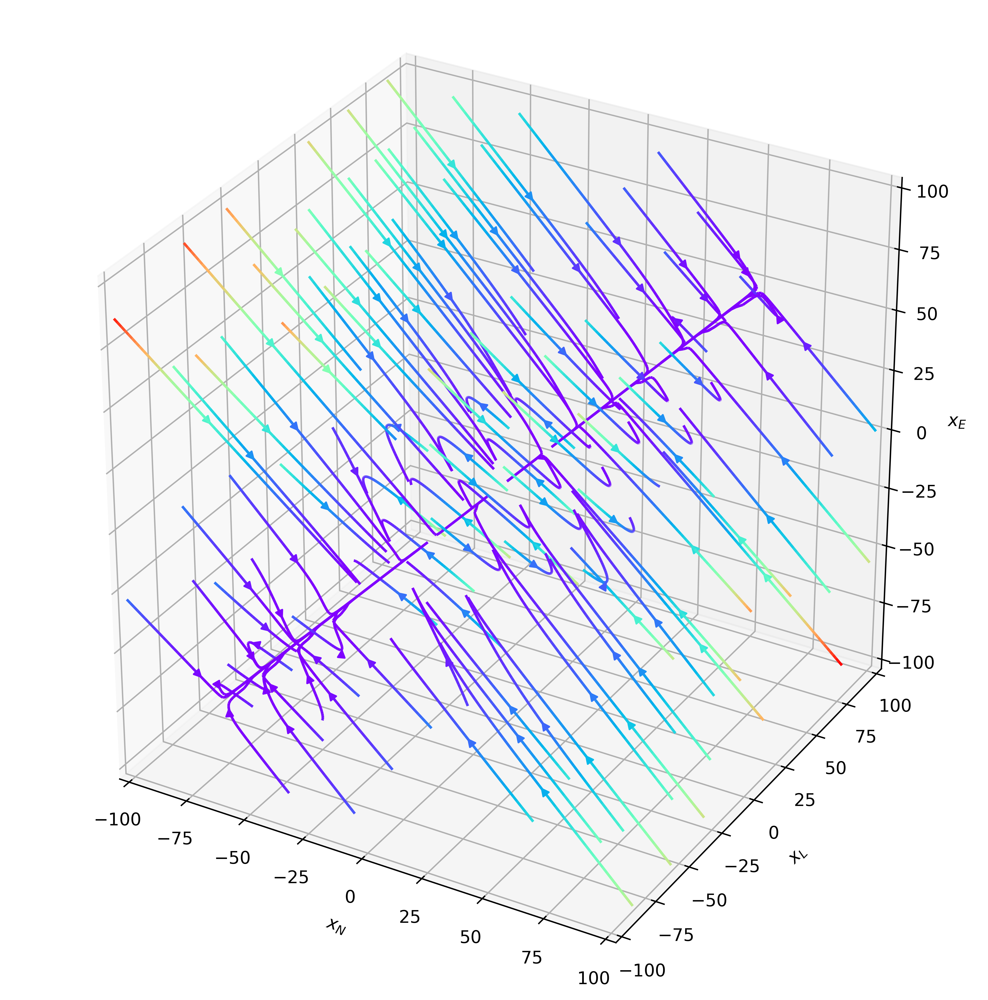

In [34]:
import matplotlib.pyplot as plt
from phaseportrait import PhasePortrait3D


psis = [1]
kd = 10**5 # Final value


alpha=1.5e-4
k = 1.5e-6
T_E = 5.554
T_L = 3.018
T_N = 0.175
# d = 1e-4
beta = 8e-4
S_0 = 34.5-35
# a_N =(k*alpha*(T_E - T_N))/(d)
# a_L = (k*alpha*(T_E - T_L))/(d)
# b = (k*beta*S_0)/(d)

for psi in psis:
    print(f"k/d = {kd}")
    a_N =(kd*alpha*(T_E - T_N))
    a_L = (kd*alpha*(T_E - T_L))
    b = (kd*beta*S_0)
    print(f"a_N = {a_N}")
    print(f"a_L = {a_L}")
    print(f"b = {b}")
    

    def three_box(x_N, x_L, x_E, psi=psi, a_N=a_N, a_L=a_L, b=b):
        x_N_n = -1/2*psi - x_N - 1/2 + abs(a_N+b*(x_N-x_E))*(x_E - x_N)
        x_L_n = -1/2*psi - x_L - 1/2 + abs(a_L+b*(x_L-x_E))*(x_E - x_L)
        x_E_n = psi + 1 - x_E - abs(a_L+b*(x_L-x_E))*(x_E - x_L) - abs(a_N+b*(x_N-x_E))*(x_E - x_N)

        return x_N_n, x_L_n, x_E_n

    plt.rcParams['figure.figsize'] = [20, 10]
    plt.rcParams['figure.dpi'] = 600

    three_box_portrait = PhasePortrait3D(three_box, [-100,100], MeshDim=8, Title=r'', xlabel=r"$x_N$", ylabel=r"$x_L$", zlabel=r"$x_E$")
    fig, ax = three_box_portrait.plot()
    plt.show()
    # save figure
    # fig.savefig(f"gif1/kd_{kd}.png")

### Reducing to a 2D system



In [35]:
import matplotlib.pyplot as plt
import numpy as np
from phaseportrait import PhasePortrait2D


psis = [10,1]
k_d = 10**5 # Final value

alpha=1.5e-4
k = 1.5e-6
T_E = 5.554
T_L = 3.018
T_N = 0.175
# d = 1e-4
beta = 8e-4
S_0 = 34.5-35
# a_N =(k*alpha*(T_E - T_N))/(d)
# a_L = (k*alpha*(T_E - T_L))/(d)
# b = (k*beta*S_0)/(d)

for psi in psis:
    a_N =(kd*alpha*(T_E - T_N))
    a_L = (kd*alpha*(T_E - T_L))
    b = (kd*beta*S_0)

    def three_box_reduced(x_N, x_L, psi=psi, a_N=a_N, a_L=a_L, b=b, S_0=S_0):
        # Conservation of Salt
        # x_E = 3*x_0 - x_N - x_L
        # where x_0 = S_reference/S_0
        x_0 = 35/S_0
        x_N_n = -1/2*psi - x_N - 1/2 + abs(a_N+b*(x_N-(3*x_0 - x_N - x_L)))*((3*x_0 - x_N - x_L) - x_N)
        x_L_n = -1/2*psi - x_L - 1/2 + abs(a_L+b*(x_L-(3*x_0 - x_N - x_L)))*((3*x_0 - x_N - x_L) - x_L)
        # x_E_n = psi + 1 - x_E - abs(a_L+b*(x_L-x_E))*(x_E - x_L) - abs(a_N+b*(x_N-x_E))*(x_E - x_N)

        return x_N_n, x_L_n

    # plt.rcParams['figure.figsize'] = [20, 10]
    plt.rcParams['figure.dpi'] = 600

    three_box_reduced_portrait = PhasePortrait2D(three_box_reduced, [-100,100], MeshDim=15, Title=f'psi={psi}', xlabel=r"$x_N$", ylabel=r"$x_L$")
    fig, ax = three_box_reduced_portrait.plot()
    plt.show()
    # save figure
    # fig.savefig(f"gif1/2D_kd_{kd}.png")

### System using real-world values

See Bifurcation analysis paper

Nordic flow: 19.203030000000002
Labrador flow: 9.053520000000002
Nordic flow: 19.203030000000002
Labrador flow: 9.053520000000002
Nordic flow: 19.203029995843977
Labrador flow: 9.053519993643727
Nordic flow: 19.20302999168795
Labrador flow: 9.05351998728745
Nordic flow: 19.20298728582144
Labrador flow: 9.053456793430245
Nordic flow: 19.202944583377544
Labrador flow: 9.05339360177329
Nordic flow: 19.20297752380299
Labrador flow: 9.053442347813847
Nordic flow: 19.20297752380299
Labrador flow: 9.053442347813847
Nordic flow: 19.20297751964696
Labrador flow: 9.05344234145757
Nordic flow: 19.202977515490932
Labrador flow: 9.053442335101295
Nordic flow: 19.202934813780452
Labrador flow: 9.053379143933283
Nordic flow: 19.20289211549258
Labrador flow: 9.053315954721052
Nordic flow: 19.202925052739886
Labrador flow: 9.05336469880583
Nordic flow: 19.202925052739886
Labrador flow: 9.05336469880583
Nordic flow: 19.20292504858386
Labrador flow: 9.053364692449554
Nordic flow: 19.202925044427833
Labra

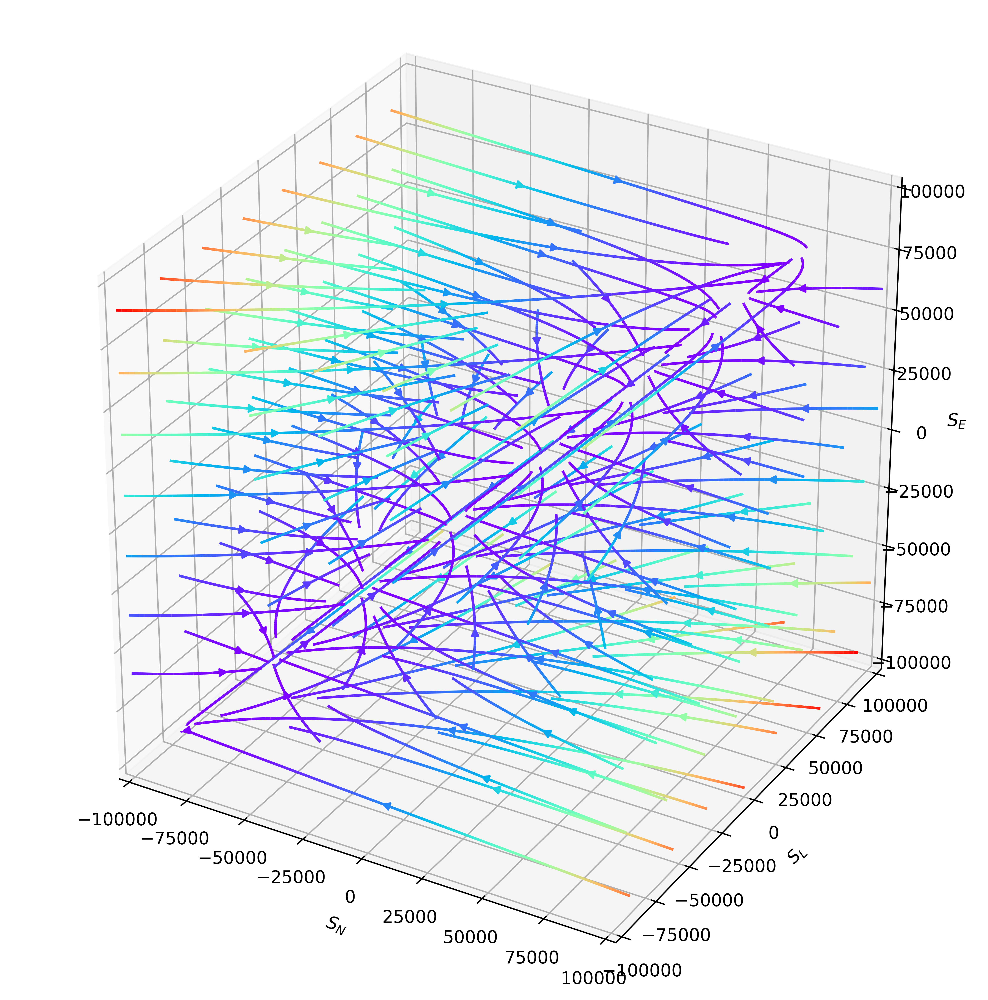

In [36]:
import matplotlib.pyplot as plt
import numpy as np
from phaseportrait import PhasePortrait3D

# List of constants

V_E, V_N, V_L = 6.3515e16,  3.2036e15, 4.007e15
S_0 = 35
alpha, beta =1.7e-4, 8e-4
T_E, T_N, T_L = 5.554, 0.175, 3.018
F_N, F_L = 0.0166, 0.0322
k = 2.1e4
F_E = F_N + F_L






def three_box_dijkstra(S_N, S_L, S_E, k=k, alpha=alpha, beta=beta, T_E=T_E, T_N=T_N, T_L=T_L, F_N=F_N, F_L=F_L, F_E=F_E, S_0=S_0, V_N=V_N, V_L=V_L, V_E=V_E):

    print(f"Nordic flow: {abs(k*(alpha*(T_E - T_N) - beta*(S_E - S_N)))}")
    print(f"Labrador flow: {abs(k*(alpha*(T_E - T_L) - beta*(S_E - S_L)))}")

    S_N_n =  (-F_N*S_0 + abs(k*(alpha*(T_E - T_N) - beta*(S_E - S_N)))*(S_E - S_N))/V_N
    S_L_n = (-F_L*S_0 + abs(k*(alpha*(T_E - T_L) - beta*(S_E - S_L)))*(S_E - S_L))/V_L
    S_E_n = (F_E*S_0 - abs(k*(alpha*(T_E - T_L) - beta*(S_E - S_L)))*(S_E - S_L) - abs(k*(alpha*(T_E - T_N) - beta*(S_E - S_N)))*(S_E - S_N))/V_E


    return S_N_n, S_L_n, S_E_n

plt.rcParams['figure.figsize'] = [20, 10]
plt.rcParams['figure.dpi'] = 600

three_box_dijkstra_portrait = PhasePortrait3D(three_box_dijkstra, [-100000,100000], MeshDim=9, Title=r'', xlabel=r"$S_N$", ylabel=r"$S_L$", zlabel=r"$S_E$")
fig, ax = three_box_dijkstra_portrait.plot()
plt.show()
# save figure
fig.savefig(f"figures/3_box_dijkstra.png")

### Reducing to 2D

In [41]:
import matplotlib.pyplot as plt
import numpy as np
from phaseportrait import PhasePortrait3D

# List of constants


def three_box_dijkstra_reduced(S_N, S_L):
    # List of constants

    V_E, V_N, V_L = 6.3515e16,  3.2036e15, 4.007e15
    V_total = V_E + V_N + V_L
    S_0 = 35
    alpha, beta =1.7e-4, 8e-4
    T_E, T_N, T_L = 5.554, 0.175, 3.018
    F_N, F_L = 0.0166, 0.0322
    k = 2.1e4
    F_E = F_N + F_L

    # due to conservation of salt
    # S_E = ((V_total*S_0 - (V_N*S_N + V_L*S_L))/V_E)


    S_N_n =  (-F_N*S_0 + abs(k*(alpha*(T_E - T_N) - beta*(((V_total*S_0 - (V_N*S_N + V_L*S_L))/V_E) - S_N)))*(((V_total*S_0 - (V_N*S_N + V_L*S_L))/V_E) - S_N))/V_N
    S_L_n = (-F_L*S_0 + abs(k*(alpha*(T_E - T_L) - beta*(((V_total*S_0 - (V_N*S_N + V_L*S_L))/V_E) - S_L)))*(((V_total*S_0 - (V_N*S_N + V_L*S_L))/V_E) - S_L))/V_L
    


    return S_N_n, S_L_n

plt.rcParams['figure.dpi'] = 600

three_box_reduced_portrait = PhasePortrait2D(three_box_dijkstra_reduced, [-10000,10000], MeshDim=30, Title=f'', xlabel=r"$S_N$", ylabel=r"$S_L$", maxLen=1e5)
fig, ax = three_box_reduced_portrait.plot()
plt.show()